In [ ]:
pip install pandas-profiling==2.7.1 

In [ ]:
import pandas as pd
import numpy as np
from sklearn.tree import DecisionTreeClassifier
from sklearn import tree
from sklearn.model_selection import train_test_split , GridSearchCV
from sklearn.metrics import accuracy_score , confusion_matrix, roc_auc_score , roc_curve
from pandas_profiling import ProfileReport

In [ ]:
df=pd.read_csv("winequality.csv",sep=';')

In [ ]:
df.head()

,fixed acidity,volatile acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol,quality
0,7.4,0.70,0.00,1.9,0.076,11.0,34.0,0.9978,3.51,0.56,9.4,5
1,7.8,0.88,0.00,2.6,0.098,25.0,67.0,0.9968,3.20,0.68,9.8,5
2,7.8,0.76,0.04,2.3,0.092,15.0,54.0,0.9970,3.26,0.65,9.8,5
3,11.2,0.28,0.56,1.9,0.075,17.0,60.0,0.9980,3.16,0.58,9.8,6
4,7.4,0.70,0.00,1.9,0.076,11.0,34.0,0.9978,3.51,0.56,9.4,5


In [ ]:
profile=ProfileReport(df)

In [ ]:
profile

Summarize dataset:   0%|          | 0/24 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [ ]:
profile.to_widgets()

/usr/local/lib/python3.7/dist-packages/pandas_profiling/profile_report.py:361: UserWarning: Ipywidgets is not yet fully supported on Google Colab (https://github.com/googlecolab/colabtools/issues/60).As an alternative, you can use the HTML report. See the documentation for more information.
  "Ipywidgets is not yet fully supported on Google Colab (https://github.com/googlecolab/colabtools/issues/60)."


Render widgets:   0%|          | 0/1 [00:00<?, ?it/s]

In [ ]:
profile.to_file('test.html')

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

In [ ]:
x=df.drop(columns='quality')

In [ ]:
y=df.quality

In [ ]:
x

,fixed acidity,volatile acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol
0,7.4,0.700,0.00,1.9,0.076,11.0,34.0,0.99780,3.51,0.56,9.4
1,7.8,0.880,0.00,2.6,0.098,25.0,67.0,0.99680,3.20,0.68,9.8
2,7.8,0.760,0.04,2.3,0.092,15.0,54.0,0.99700,3.26,0.65,9.8
3,11.2,0.280,0.56,1.9,0.075,17.0,60.0,0.99800,3.16,0.58,9.8
4,7.4,0.700,0.00,1.9,0.076,11.0,34.0,0.99780,3.51,0.56,9.4
...,...,...,...,...,...,...,...,...,...,...,...
1594,6.2,0.600,0.08,2.0,0.090,32.0,44.0,0.99490,3.45,0.58,10.5
1595,5.9,0.550,0.10,2.2,0.062,39.0,51.0,0.99512,3.52,0.76,11.2
1596,6.3,0.510,0.13,2.3,0.076,29.0,40.0,0.99574,3.42,0.75,11.0
1597,5.9,0.645,0.12,2.0,0.075,32.0,44.0,0.99547,3.57,0.71,10.2


In [ ]:
y

0       5
1       5
2       5
3       6
4       5
       ..
1594    5
1595    6
1596    6
1597    5
1598    6
Name: quality, Length: 1599, dtype: int64

In [ ]:
x_train,x_test,y_train,y_test=train_test_split(x,y,test_size=0.20,random_state=0)

In [ ]:
x_train

,fixed acidity,volatile acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol
642,9.9,0.540,0.45,2.3,0.071,16.0,40.0,0.99910,3.39,0.62,9.4
679,10.8,0.260,0.45,3.3,0.060,20.0,49.0,0.99720,3.13,0.54,9.6
473,9.9,0.350,0.55,2.1,0.062,5.0,14.0,0.99710,3.26,0.79,10.6
390,5.6,0.850,0.05,1.4,0.045,12.0,88.0,0.99240,3.56,0.82,12.9
1096,6.6,0.725,0.09,5.5,0.117,9.0,17.0,0.99655,3.35,0.49,10.8
...,...,...,...,...,...,...,...,...,...,...,...
763,9.3,0.655,0.26,2.0,0.096,5.0,35.0,0.99738,3.25,0.42,9.6
835,7.6,0.665,0.10,1.5,0.066,27.0,55.0,0.99655,3.39,0.51,9.3
1216,7.9,0.570,0.31,2.0,0.079,10.0,79.0,0.99677,3.29,0.69,9.5
559,13.0,0.470,0.49,4.3,0.085,6.0,47.0,1.00210,3.30,0.68,12.7


In [ ]:
y_train

642     5
679     5
473     5
390     8
1096    6
       ..
763     5
835     5
1216    6
559     6
684     5
Name: quality, Length: 1279, dtype: int64

In [ ]:
x_test

,fixed acidity,volatile acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol
1109,10.8,0.470,0.43,2.10,0.171,27.0,66.0,0.99820,3.17,0.76,10.8
1032,8.1,0.820,0.00,4.10,0.095,5.0,14.0,0.99854,3.36,0.53,9.6
1002,9.1,0.290,0.33,2.05,0.063,13.0,27.0,0.99516,3.26,0.84,11.7
487,10.2,0.645,0.36,1.80,0.053,5.0,14.0,0.99820,3.17,0.42,10.0
979,12.2,0.450,0.49,1.40,0.075,3.0,6.0,0.99690,3.13,0.63,10.4
...,...,...,...,...,...,...,...,...,...,...,...
794,10.1,0.270,0.54,2.30,0.065,7.0,26.0,0.99531,3.17,0.53,12.5
813,6.9,0.390,0.24,2.10,0.102,4.0,7.0,0.99462,3.44,0.58,11.4
1322,9.1,0.340,0.42,1.80,0.058,9.0,18.0,0.99392,3.18,0.55,11.4
704,9.1,0.765,0.04,1.60,0.078,4.0,14.0,0.99800,3.29,0.54,9.7


In [ ]:
y_test

1109    6
1032    5
1002    7
487     6
979     5
       ..
794     6
813     4
1322    5
704     4
1023    6
Name: quality, Length: 320, dtype: int64

In [ ]:
dt_model=DecisionTreeClassifier()

In [ ]:
dt_model.fit(x_train,y_train)

DecisionTreeClassifier()

In [ ]:
from sklearn import tree
import matplotlib.pyplot as plt
%matplotlib inline

[Text(486.24327927492976, 1061.3142857142857, 'X[10] <= 10.35\ngini = 0.648\nsamples = 1279\nvalue = [8, 42, 546, 496, 172, 15]'),
 Text(243.48823735955057, 1009.5428571428572, 'X[9] <= 0.585\ngini = 0.527\nsamples = 703\nvalue = [5, 23, 428, 222, 24, 1]'),
 Text(49.25114115168539, 957.7714285714286, 'X[10] <= 9.075\ngini = 0.42\nsamples = 331\nvalue = [3, 15, 242, 69, 2, 0]'),
 Text(9.404494382022472, 906.0, 'X[6] <= 71.0\ngini = 0.587\nsamples = 15\nvalue = [0, 2, 5, 8, 0, 0]'),
 Text(6.269662921348314, 854.2285714285715, 'X[7] <= 0.996\ngini = 0.43\nsamples = 11\nvalue = [0, 2, 1, 8, 0, 0]'),
 Text(3.134831460674157, 802.4571428571429, 'gini = 0.0\nsamples = 2\nvalue = [0, 2, 0, 0, 0, 0]'),
 Text(9.404494382022472, 802.4571428571429, 'X[8] <= 3.08\ngini = 0.198\nsamples = 9\nvalue = [0, 0, 1, 8, 0, 0]'),
 Text(6.269662921348314, 750.6857142857143, 'gini = 0.0\nsamples = 1\nvalue = [0, 0, 1, 0, 0, 0]'),
 Text(12.539325842696629, 750.6857142857143, 'gini = 0.0\nsamples = 8\nvalue = [0

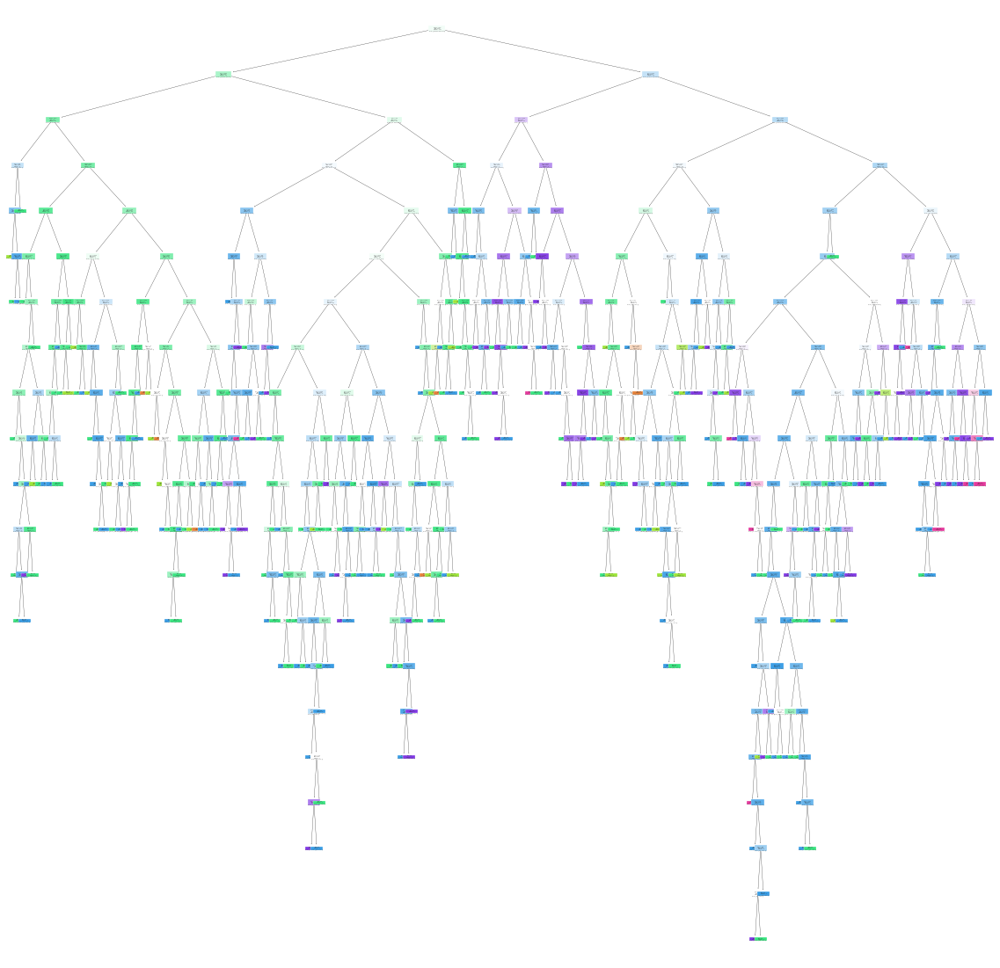

In [ ]:
plt.figure(figsize=(20,20))
tree.plot_tree(dt_model ,filled=True)

In [ ]:
df1=df.head(30)

In [ ]:
x1=df1.drop(columns='quality')

In [ ]:
y1=df1.quality

In [ ]:
dt1_model=DecisionTreeClassifier()
dt1_model.fit(x1,y1)

DecisionTreeClassifier()

In [ ]:
plt.figure(figsize=(20,20))
tree.plot_tree(dt1_model,filled=True ,class_names=[str(i) for i in set(y1)] ,feature_names=x1.columns)

[Text(659.4545454545455, 996.6, 'citric acid <= 0.42\ngini = 0.471\nsamples = 30\nvalue = [1, 21, 5, 3]\nclass = 5'),
 Text(405.8181818181818, 815.4000000000001, 'total sulfur dioxide <= 22.0\ngini = 0.334\nsamples = 26\nvalue = [1, 21, 2, 2]\nclass = 5'),
 Text(202.9090909090909, 634.2, 'chlorides <= 0.076\ngini = 0.625\nsamples = 4\nvalue = [0, 1, 1, 2]\nclass = 7'),
 Text(101.45454545454545, 453.0, 'gini = 0.0\nsamples = 2\nvalue = [0, 0, 0, 2]\nclass = 7'),
 Text(304.3636363636364, 453.0, 'volatile acidity <= 0.527\ngini = 0.5\nsamples = 2\nvalue = [0, 1, 1, 0]\nclass = 5'),
 Text(202.9090909090909, 271.79999999999995, 'gini = 0.0\nsamples = 1\nvalue = [0, 1, 0, 0]\nclass = 5'),
 Text(405.8181818181818, 271.79999999999995, 'gini = 0.0\nsamples = 1\nvalue = [0, 0, 1, 0]\nclass = 6'),
 Text(608.7272727272727, 634.2, 'alcohol <= 9.05\ngini = 0.169\nsamples = 22\nvalue = [1, 20, 1, 0]\nclass = 5'),
 Text(507.27272727272725, 453.0, 'gini = 0.0\nsamples = 1\nvalue = [1, 0, 0, 0]\nclass =

In [ ]:
set(y1)

In [ ]:
dt1_model.predict(x1)

In [ ]:
dt1_model.score(x1,y1)

In [ ]:
dt1_model.score(x_test,y_test)

cost_complecxity_pruning_path : finding the gini index

In [ ]:
path=dt1_model.cost_complexity_pruning_path(x1,y1)


In [ ]:
path

In [ ]:
ccp_alpha=path['ccp_alphas']
ccp_alpha

In [ ]:
dt2_model=[]
for ccp in ccp_alpha:
    dt_m=DecisionTreeClassifier(ccp_alpha=ccp)
    dt_m.fit(x1,y1)
    dt2_model.append(dt_m)

In [ ]:
dt2_model

In [ ]:
training_score=[i.score(x1,y1) for i in dt2_model]

In [ ]:
training_score=[i.score(x_test,y_test) for i in dt2_model]

In [ ]:
dt_model_cpp=DecisionTreeClassifier(random_state=0,ccp_alpha=0.014)
dt_model_cpp.fit(x,y)

In [ ]:
plt.figure(figsize=(20,20))
tree.plot_tree(dt_model_cpp,filled=True)

In [ ]:
dt_model_cpp.score(x,y)

In [ ]:
dt_model_cpp.score(x_test,y_test)

In [ ]:
DecisionTreeClassifier()

In [ ]:
grid_pram={"criterion":['gini','entropy'],
           "splitter":['best','random'],
           "max_depth":range(2,40,1),
           "min_samples_leaf":range(1,10,1),
           "ccp_alpha":np.random.rand(20)
}

In [ ]:
grid_ccp=GridSearchCV(param_grid=grid_pram,estimator=dt_model_cpp,cv=5,n_jobs=-1)

In [ ]:
grid_ccp.fit(x,y)

In [ ]:
grid_ccp.best_params_

In [ ]:
dt_cpp_new = DecisionTreeClassifier(criterion='entropy' , max_depth=17 ,min_samples_leaf=1 , min_samples_split=3 , splitter='random',ccp_alpha=0.014)

In [ ]:
dt_cpp_new.fit(x1,y1)

In [ ]:
dt_cpp_new.score(x1,y1)

In [ ]:
dt_cpp_new.score(x_test,y_test)

In [ ]:
pred = dt_cpp_new.predict(x_train)

In [ ]:
confusion_matrix(y_train,pred)